# SCRIPT FOR ANALYSIS OF CELLS ANALYZED WITH Xenium

This notebook is used to identify cell populations from a Xenium dataset. The analysis is based on Scanpy (documentation in  https://scanpy.readthedocs.io/en/stable/index.html) and Squidpy (documentation in https://squidpy.readthedocs.io/en/stable/)

## Loading the packages

We import the packages needed for it. If something fails, means that we haven't installed something in the environment

In [36]:
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import matplotlib.pyplot as plt
import xb.plotting as xp

## Importing the data and creating an anndata object

We import the adata object for each of the three technical replicates. We remove articitial/control genes and we add a tag to every cell to distinguish the replicate they are comming from

In [37]:
adata1=sc.read(r"../../data/unprocessed_adata/ms_brain_rep1.h5ad")
adata2=sc.read(r"../../data/unprocessed_adata/ms_brain_rep2.h5ad")
adata3=sc.read(r"../../data/unprocessed_adata/ms_brain_rep3.h5ad")
adata1=adata1[:,adata1.var['in_panel']]
adata2=adata2[:,adata2.var['in_panel']]
adata3=adata3[:,adata3.var['in_panel']]
adata1.obs['replicate']='1'
adata2.obs['replicate']='2'
adata3.obs['replicate']='3'

/tmp/ipykernel_98/2655493395.py:7: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata1.obs['replicate']='1'
/tmp/ipykernel_98/2655493395.py:8: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata2.obs['replicate']='2'
/tmp/ipykernel_98/2655493395.py:9: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata3.obs['replicate']='3'


We concatenate the three adata objects together

In [38]:
adata=sc.concat([adata1,adata2,adata3])

/home/sergioms/.local/lib/python3.8/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


The object where our data is contained is called anndata (documentation in https://anndata.readthedocs.io/en/latest/). The expression is stored in adata.X. The metadata is stored in adata.obs. The data associated with the genes is stored in adata.var

/home/sergioms/.local/lib/python3.8/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


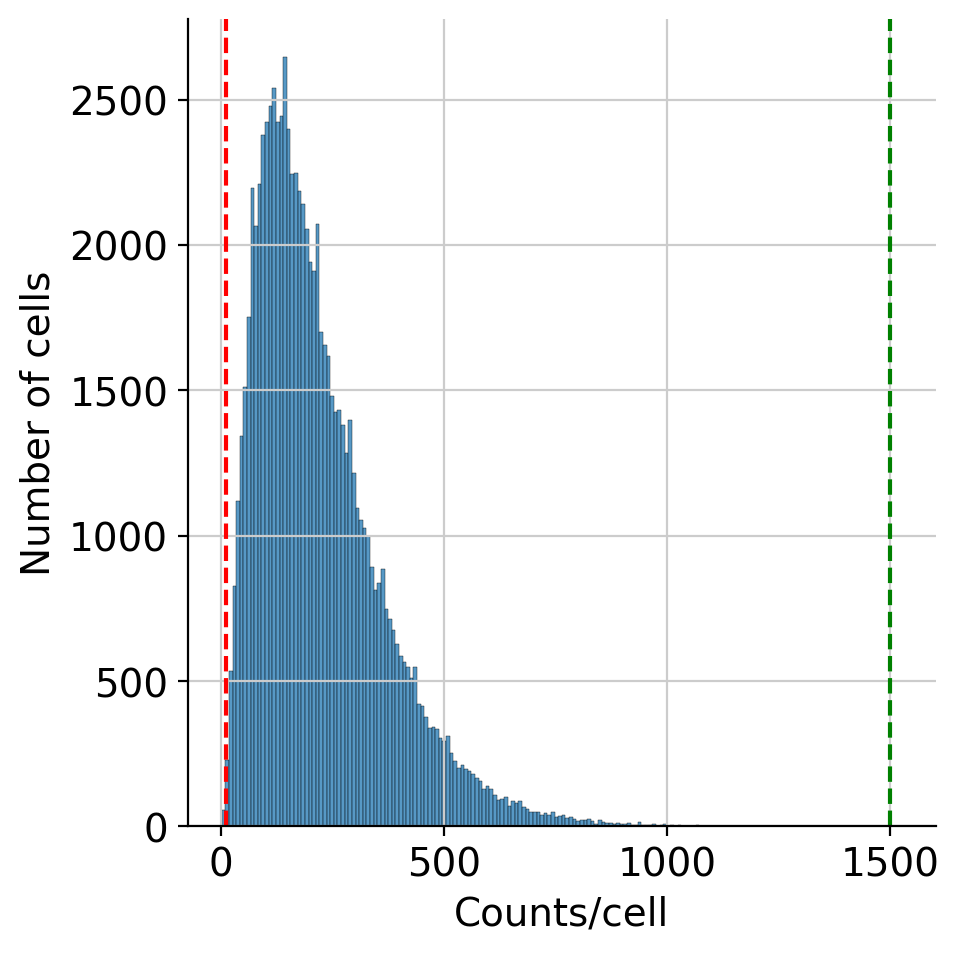

In [39]:
maximum_number_of_reads=1500
minimum_number_of_reads=10
adata.obs=adata.obs.reset_index()
adata.obs['total_counts']=list(np.sum(adata.X,axis=1))
sns.displot(adata.obs,x='total_counts')
plt.xlabel('Counts/cell')
plt.ylabel('Number of cells')
plt.axvline(x=maximum_number_of_reads,color='green',linestyle='--')
plt.axvline(x=minimum_number_of_reads,color='red',linestyle='--')
sc.pp.filter_cells(adata,min_counts=minimum_number_of_reads)
sc.pp.filter_cells(adata,max_counts=maximum_number_of_reads)
plt.savefig('../../figures/celltype_identification_mscoronal/countsxcell_histogram.pdf')

# Normalization of the data

We now save the raw data in adata.raw and apply normalization and log-transformation to minimize the effect of outliers. We also scale the data to give the same importance to all genes in clustering

In [40]:
adata.layers['raw']=adata
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

[OPTIONAL] After normalizing and logmarizing, the data we CAN, if we wish, filter only highly variable genes for clustering. This step is key in the analysis of single cell RNA sequencing datasets (with +20.000 genes) but it's not that useful in targeted methods such as ISS. However, it can help to keep variables only for clustering

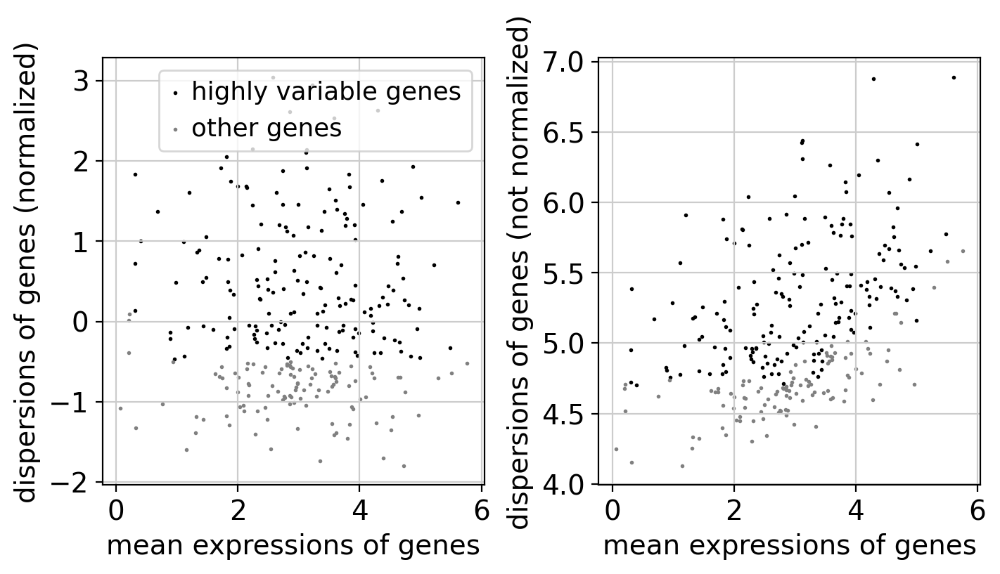

In [41]:
plt.rcParams['figure.facecolor'] = 'white'
sc.pp.highly_variable_genes(adata, min_mean=0.3, max_mean=7, min_disp=-0.5)
sc.pl.highly_variable_genes(adata)

[OPTIONAL] We can also scale the data. This means that we scale the expression of every gene between 0 and 1. This will give decrease the impact of highly expressed genes and will increase the importance of lowly expressed genes. Let's not scale in this case

In [42]:
#sc.pp.scale(adata,max_value=100)

# Dimensional reduction and clustering

We apply principal component analysis to find the appropiate nubmer of components to use to perform dimensionality reduction and clustering

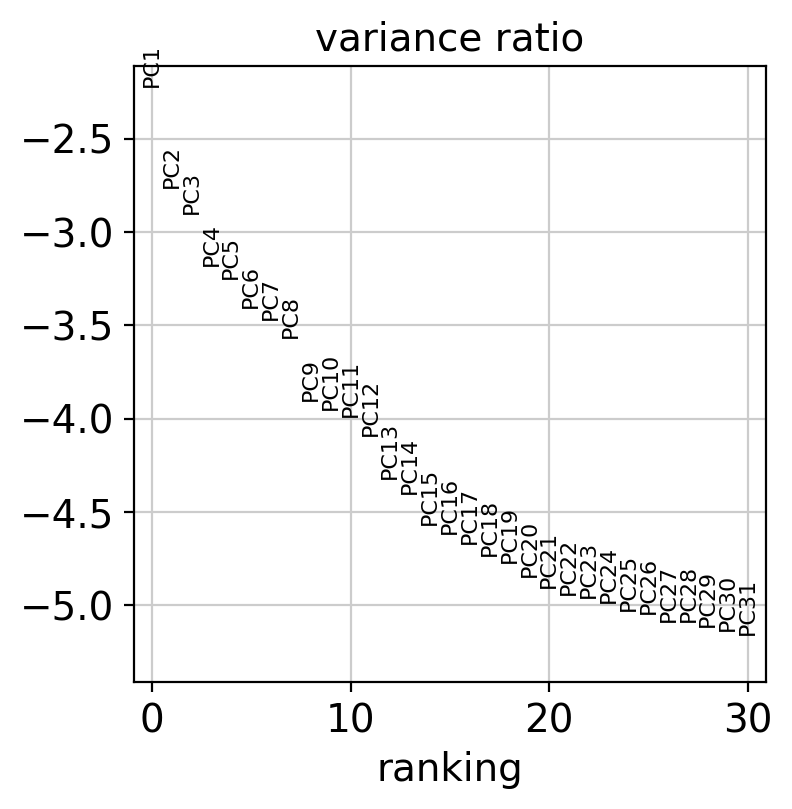

In [43]:
sc.tl.pca(adata, svd_solver='arpack')
plt.rcParams['figure.facecolor'] = 'white'
sc.pl.pca_variance_ratio(adata, log=True)

We select to go with the top X first principal components to look for the nearest neighbors. We are going to represent our data using graph-based methods, like UMAP. For this, we first need to create a graph by linking each cell to the n closest neighbors (n_neighbors) in the dataset. We can select the numbers of principal components to use

In [44]:
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=40)

We can, then, run clustering, by calling either leiden or louvain clustering. By changing the parameter "resolution" we will generate more or less clusters. Higher resolution means more clusters. The clusters (groups of cells) are indepent from its visualization, which we will create using UMAP later on

In [45]:
sc.tl.leiden(adata,resolution=2.2,key_added='leiden_2_2')
sc.tl.leiden(adata,resolution=1.8,key_added='leiden_1_8')
sc.tl.leiden(adata,resolution=1.4,key_added='leiden_1_4')
sc.tl.leiden(adata,resolution=1.0,key_added='leiden_1_0')
sc.tl.leiden(adata,resolution=0.8,key_added='leiden_0_8')
sc.tl.leiden(adata,resolution=0.6,key_added='leiden_0_6')

To VISUALIZE the diversity of our cells, We perfrom UMAP. The closest two spots are in UMAP, the more similar they will be. With the comand sc.tl.umap. we CALCULATE the UMAP embedding. With sc.pl.umap will VISUALIZE the UMAP.

In [46]:
sc.tl.umap(adata,min_dist=0.1)

On top of the UMAP you can visualize any variable that you might be interested (a metadata column or gene expression). We need to modify the parameter "color" to visualize the appropiate variable on the UMAP

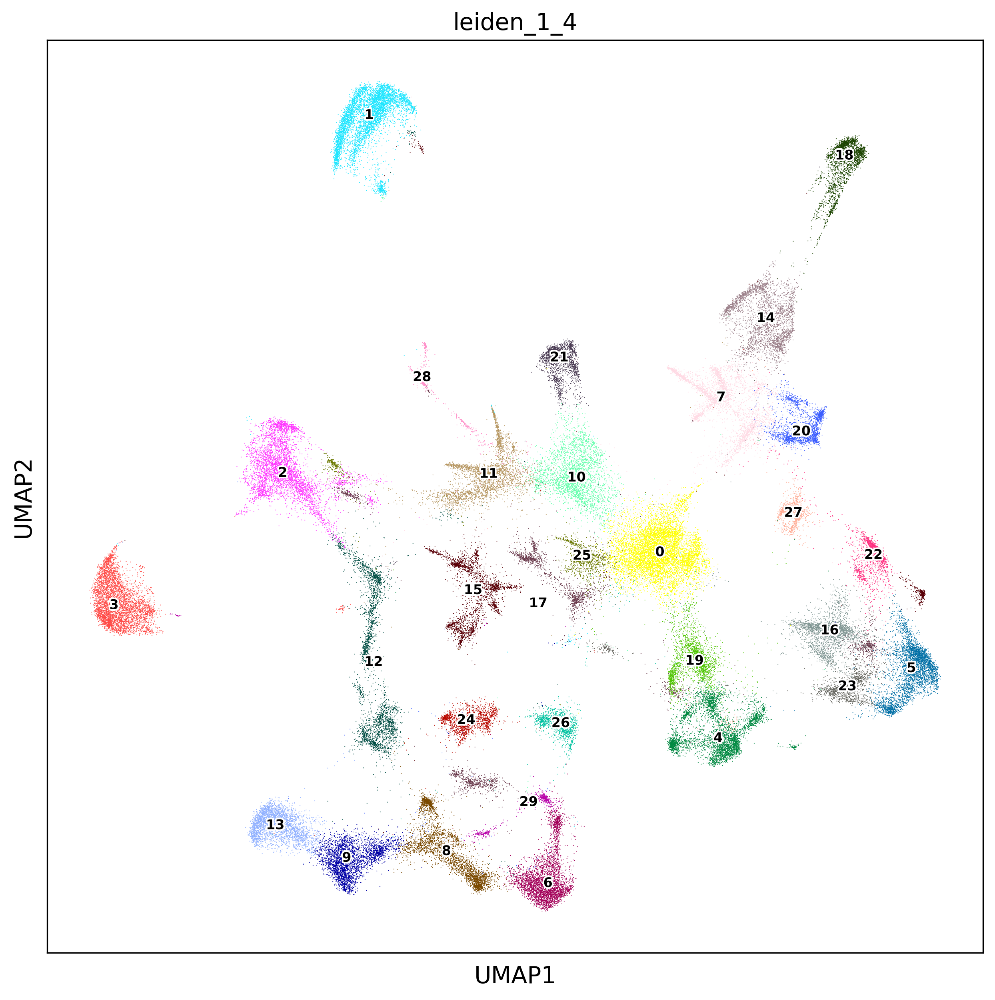

In [48]:
sc.set_figure_params(scanpy=True, dpi=150,figsize=(10,10))
plt.rcParams['figure.facecolor'] = 'white'
sc.pl.umap(adata,color=['leiden_1_4'],size=1,legend_loc='on data',legend_fontsize=8,legend_fontoutline=2,show=False)
plt.savefig('../../figures/celltype_identification_mscoronal/msbrain_3rep_leiden_1_4_ondata.pdf',bbox_inches='tight')

Identify markers using rank gene groups

In [49]:
sc.tl.rank_genes_groups(adata, 'leiden_1_4', method='wilcoxon', key_added = "wilcoxon")
sc.pl.rank_genes_groups(adata, n_genes=5, sharey=False, key="wilcoxon",fontsize=15,show=False)
plt.savefig('../../figures/celltype_identification_mscoronal/original_leiden_3repl_1_4_deg_update.pdf',bbox_inches='tight')

/home/sergioms/.local/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/home/sergioms/.local/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/home/sergioms/.local/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:399: PerformanceWarning: DataFrame is highly fragmente

We aim to annotate the clusters.For this we looked at DEG genes and location to identify their cell type

In [50]:
annotation=pd.read_csv(r"../../data/annotation_dictionaries/number_to_annotation_updated_cluster_3rep.csv",sep=';')
cluster14_initialannotation=dict(zip(annotation['cluster_1_4'],annotation['original_annotation']))
cluster14_Class=dict(zip(annotation['cluster_1_4'],annotation['Class']))
adata.obs['Class']=adata.obs['leiden_1_4'].astype(int).map(cluster14_Class)
adata.obs['initial_annotation']=adata.obs['leiden_1_4'].astype(str)+'_'+adata.obs['leiden_1_4'].astype(int).map(cluster14_initialannotation)
adata.obs['celltype_annotation']=adata.obs['leiden_1_4'].astype(int).map(cluster14_initialannotation)
adata.obs['cell_code']=list(adata.obs['cell_id'].astype(str)+'_'+adata.obs['replicate'].astype(str))

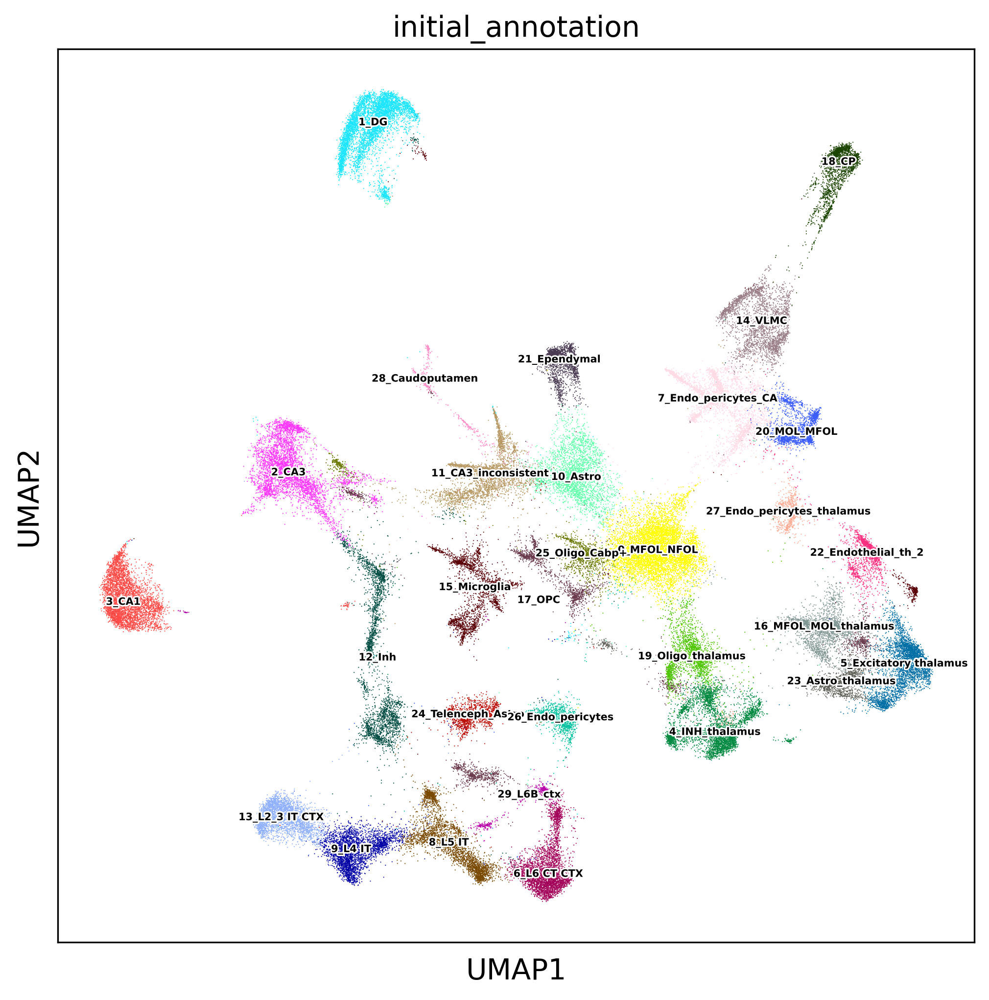

In [53]:
sc.set_figure_params(scanpy=True, dpi=150,figsize=(8,8))
plt.rcParams['figure.facecolor'] = 'white'
sc.pl.umap(adata,color=['initial_annotation'],size=1,legend_loc='on data',legend_fontsize=5,legend_fontoutline=1.5,show=False)
plt.savefig('../../figures/celltype_identification_mscoronal/msbrain_3rep_initial_annotation_ondata.pdf',bbox_inches='tight')

Finally, before saving we transform the XY to coordinate space so that we can visualize it on top of the nuclear stainings

In [54]:
adata.obs['X']=adata.obs['x_centroid']*4.70588
adata.obs['Y']=adata.obs['y_centroid']*4.70588
import scipy as sp
adata.X = sp.sparse.csr_matrix(adata.X)

In [80]:
adata.layers['raw']=sc.AnnData(adata.layers['raw'].X,obs=adata.layers['raw'].obs,var=adata.layers['raw'].var)

# Saving the object

In [90]:
saving_path=r'../../data/processed_adata/'
adata.write(saving_path+'/adata_msbrain_3rep_withclusters.h5ad')

# Reading the object again if needed

In [113]:
saving_path=r'../../data/processed_adata/'
adata=sc.read(saving_path+'/adata_msbrain_3rep_withclusters.h5ad')

# Saving the UMAPs with other levels of info

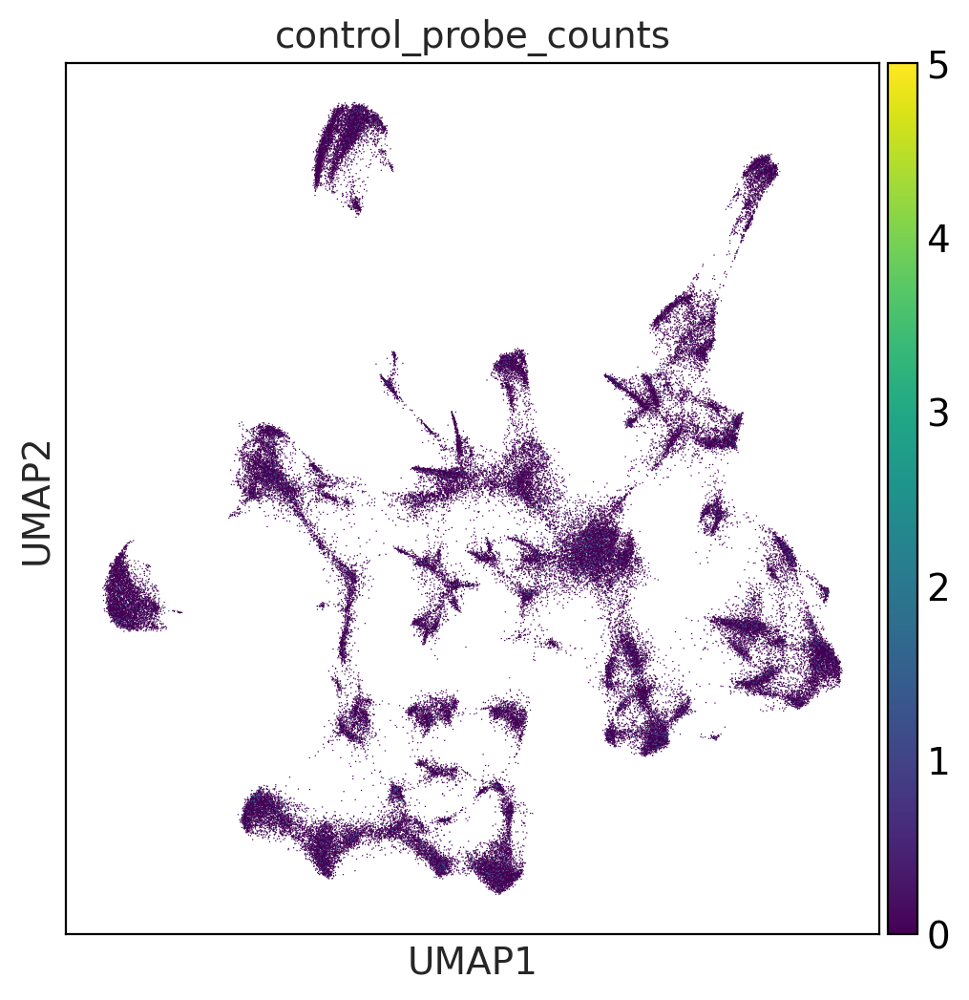

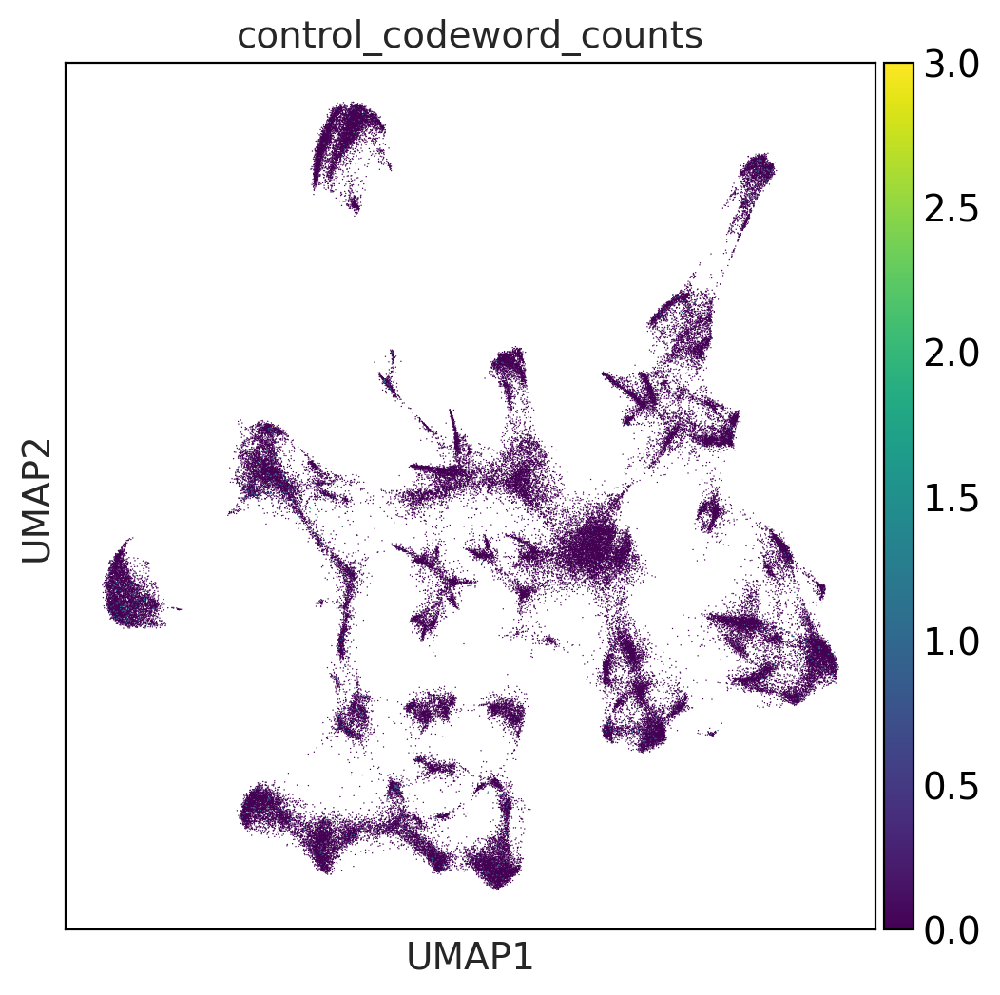

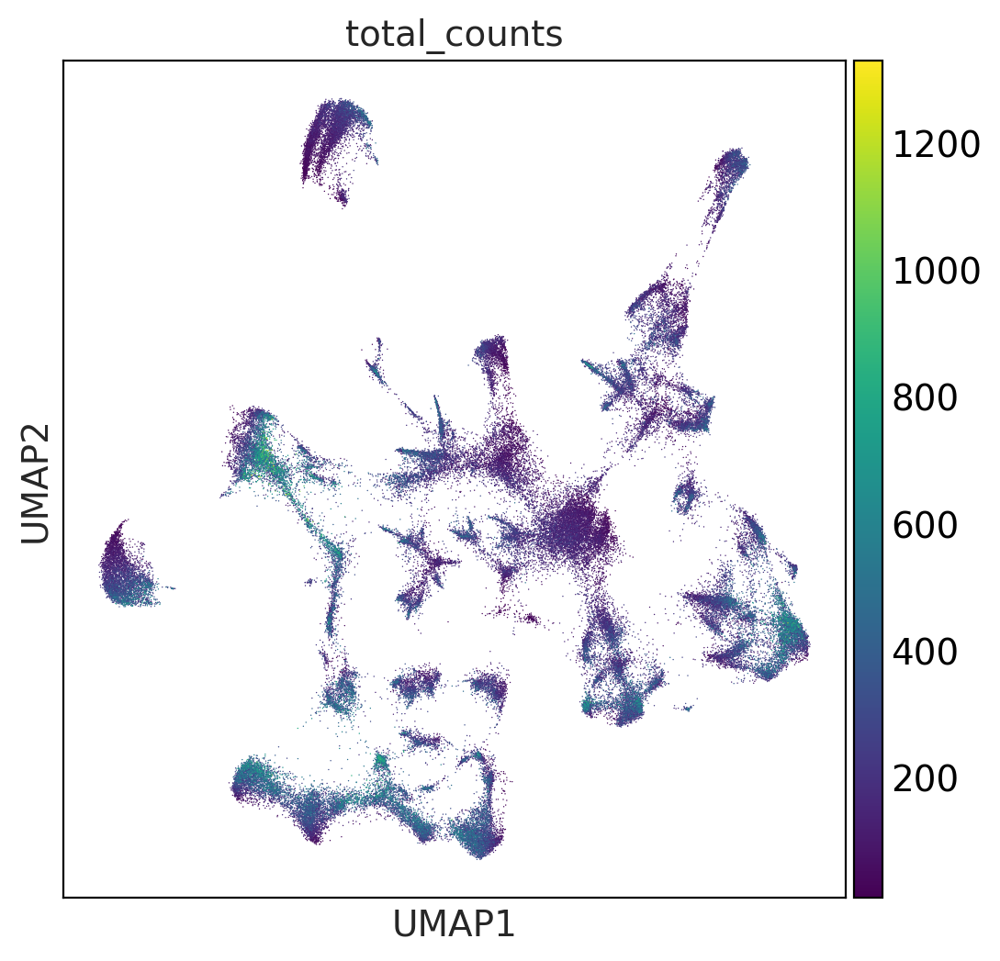

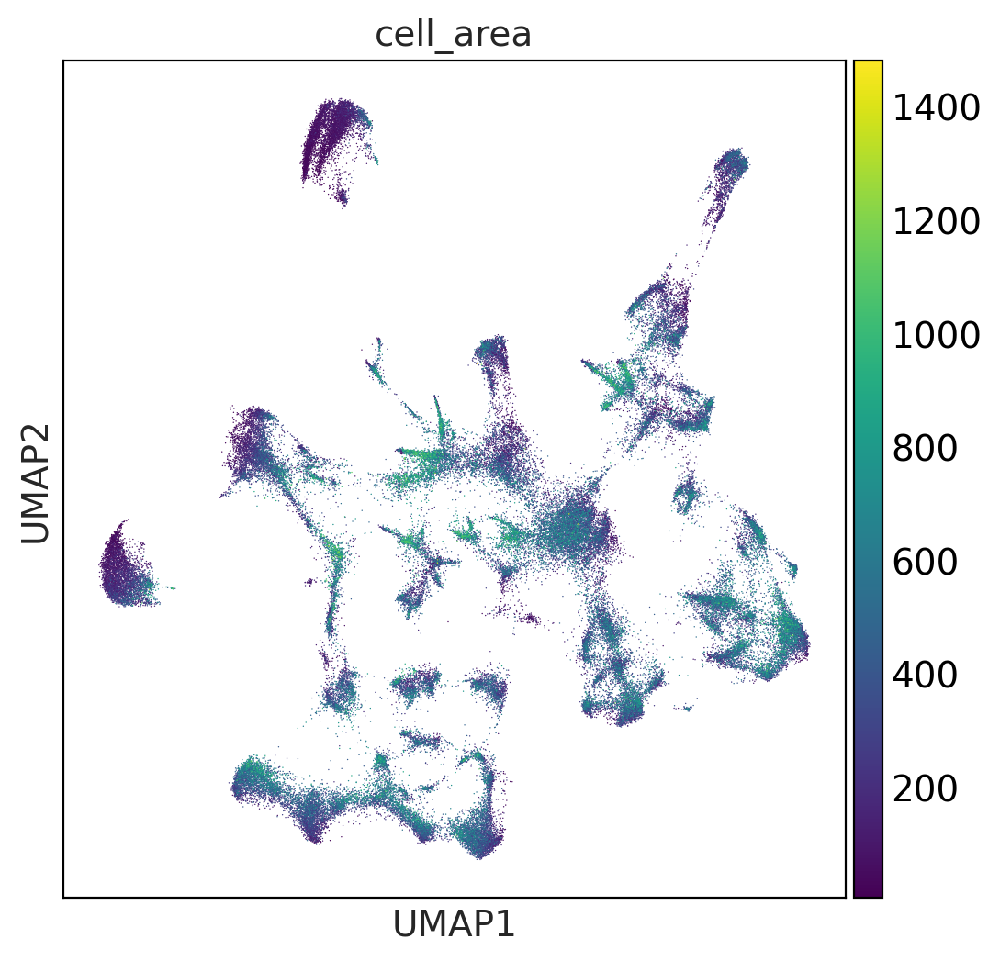

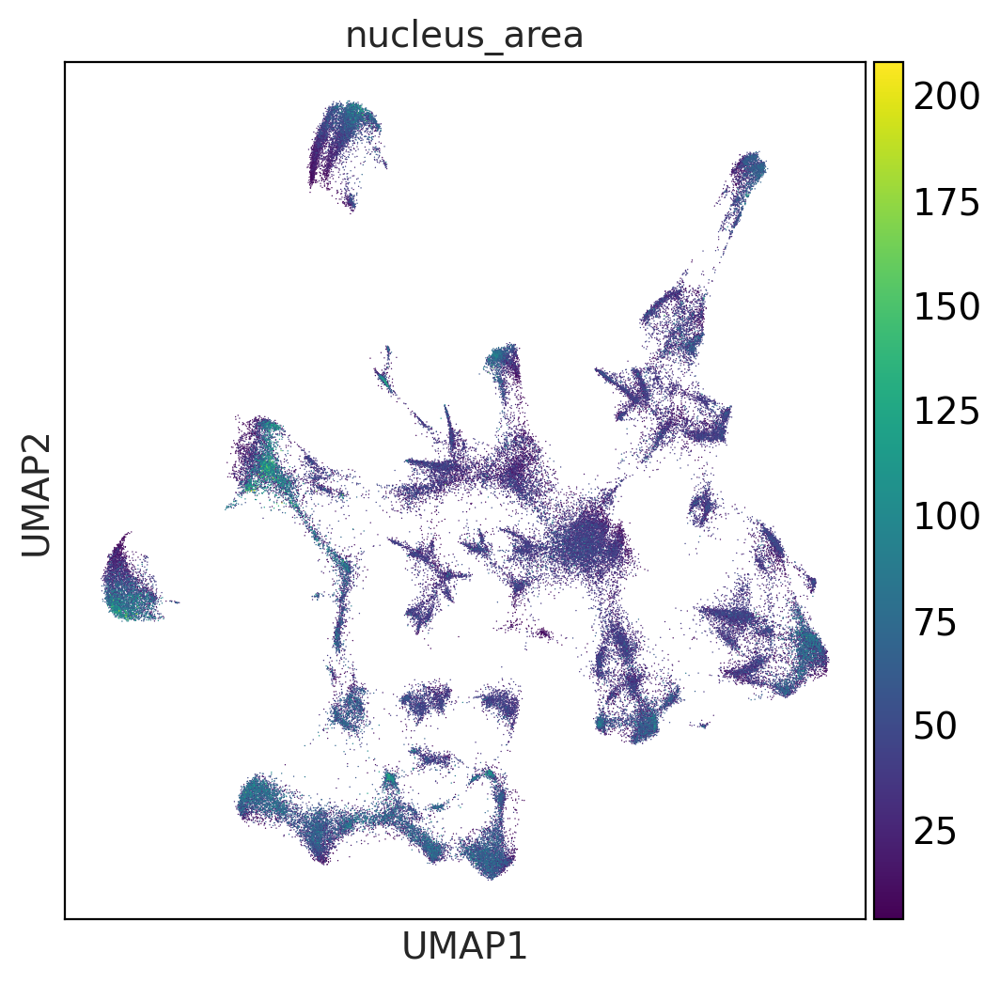

...

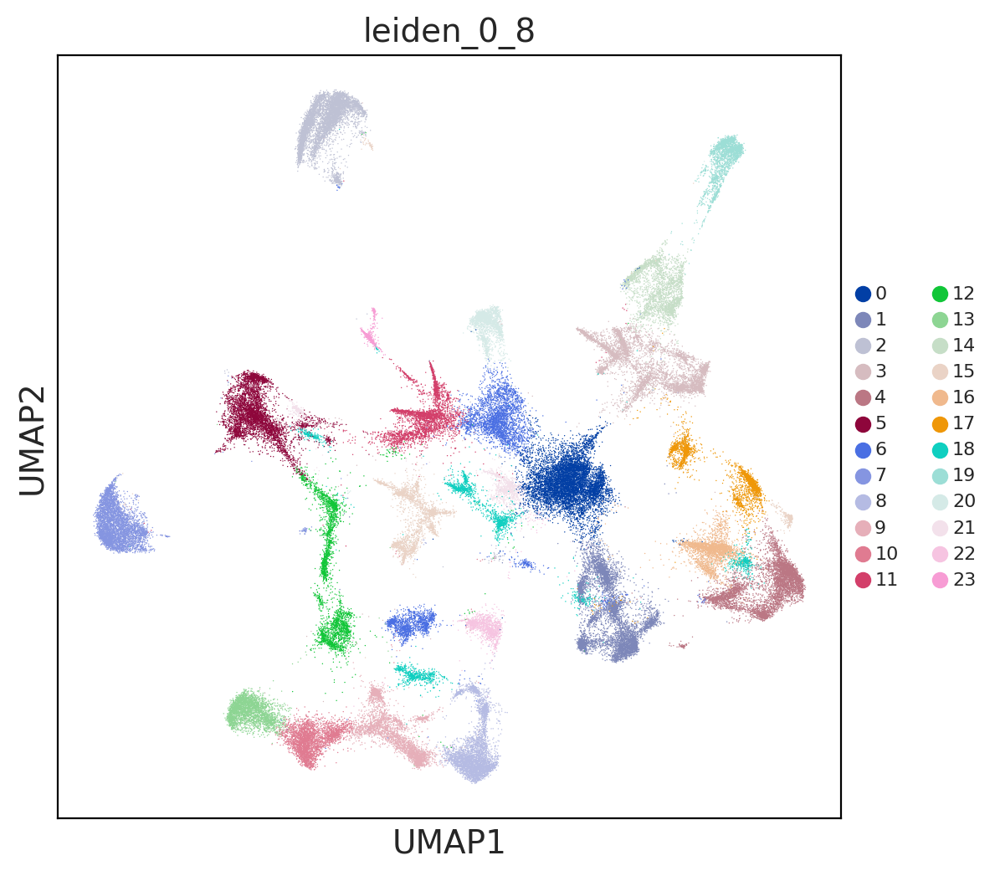

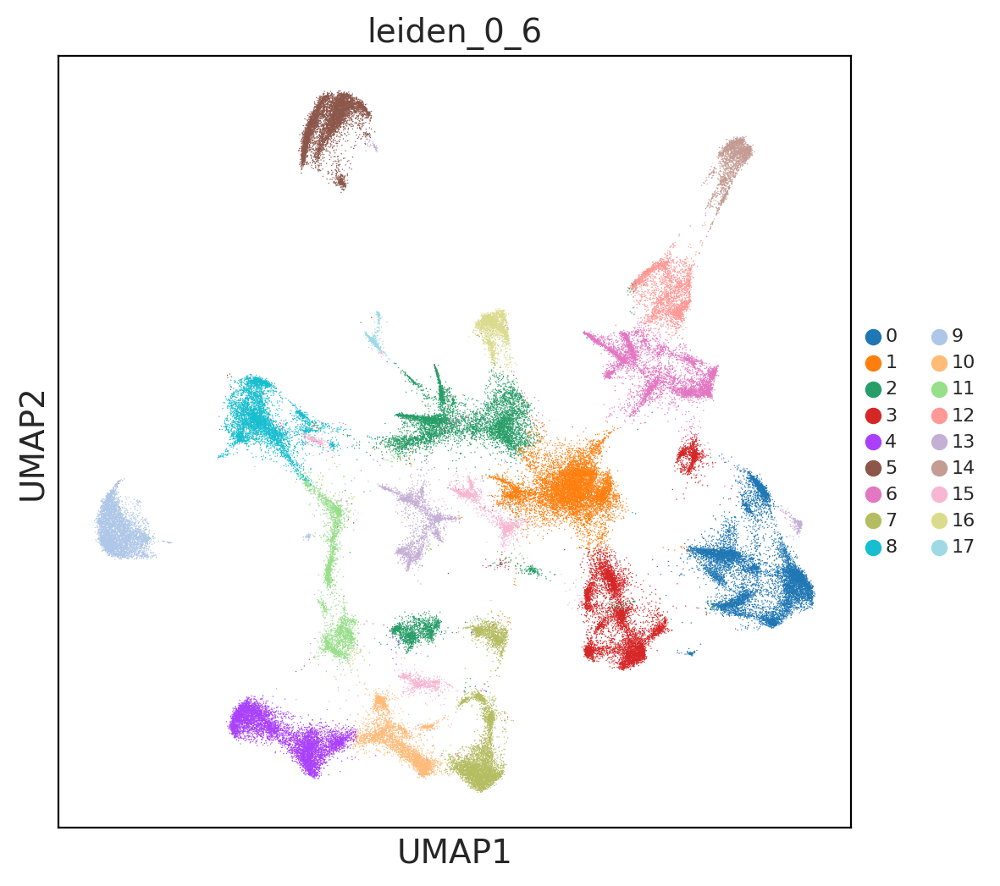

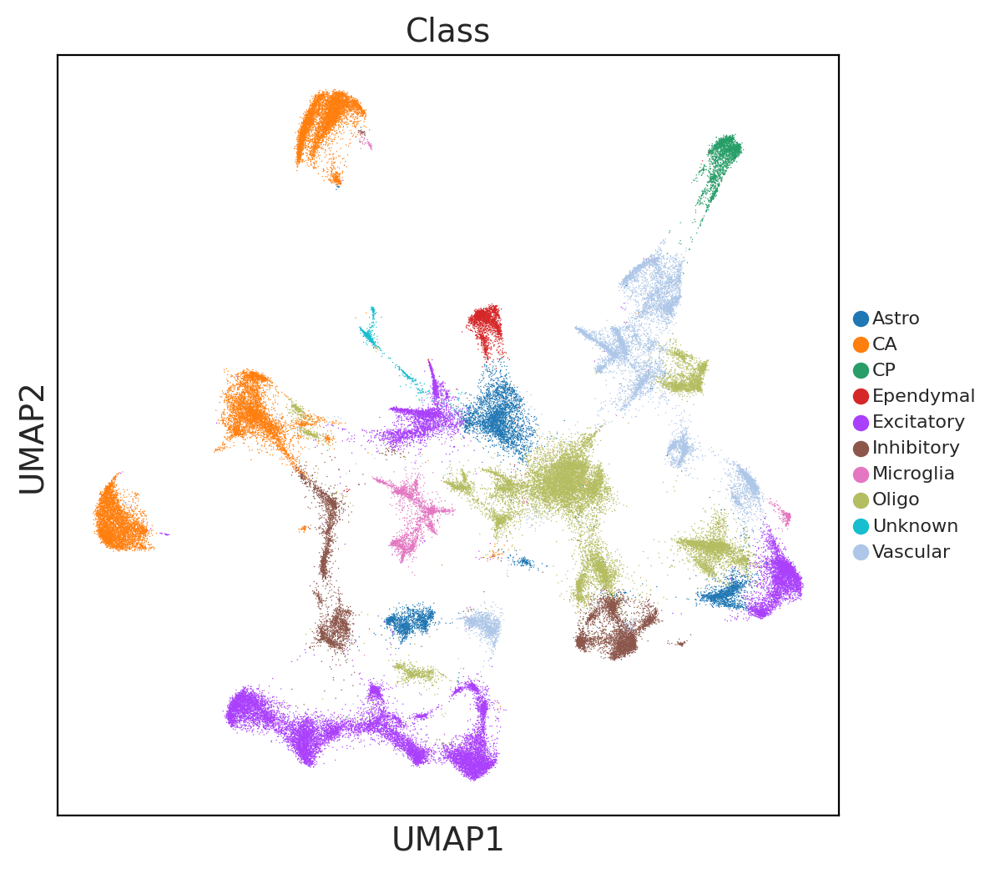

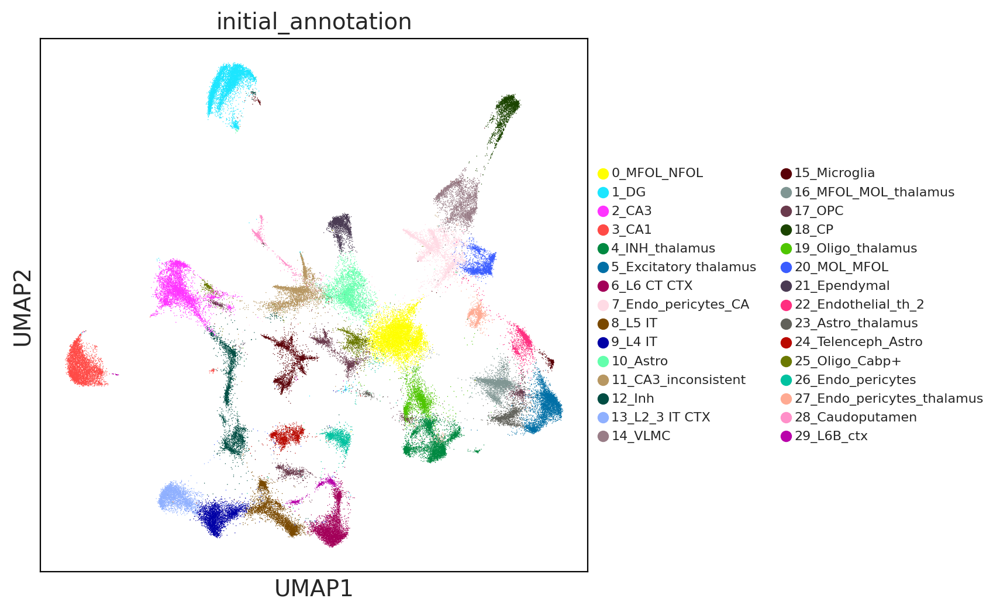

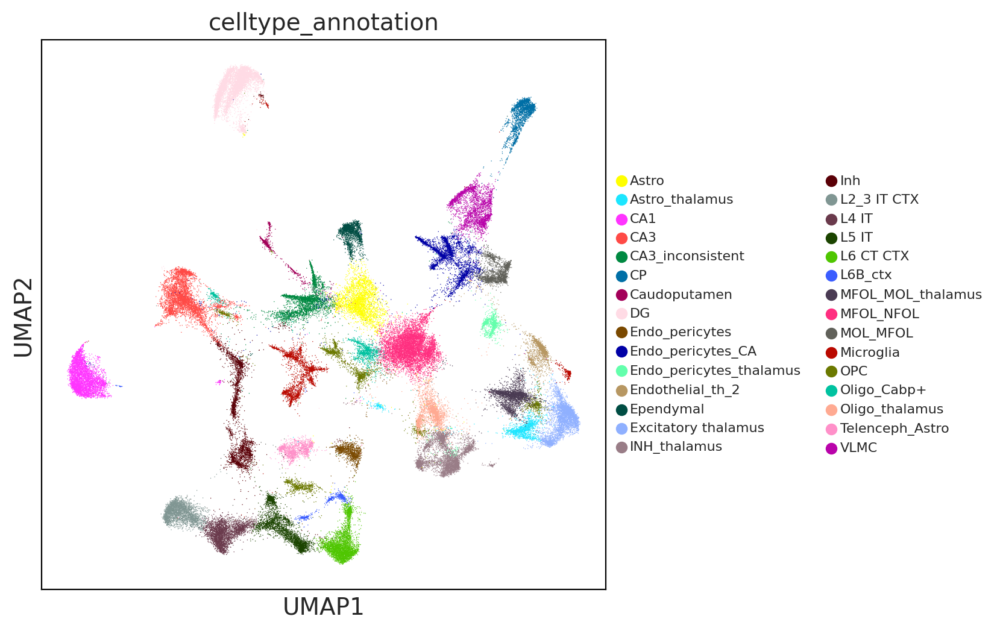

TypeError: bad operand type for unary -: 'str'

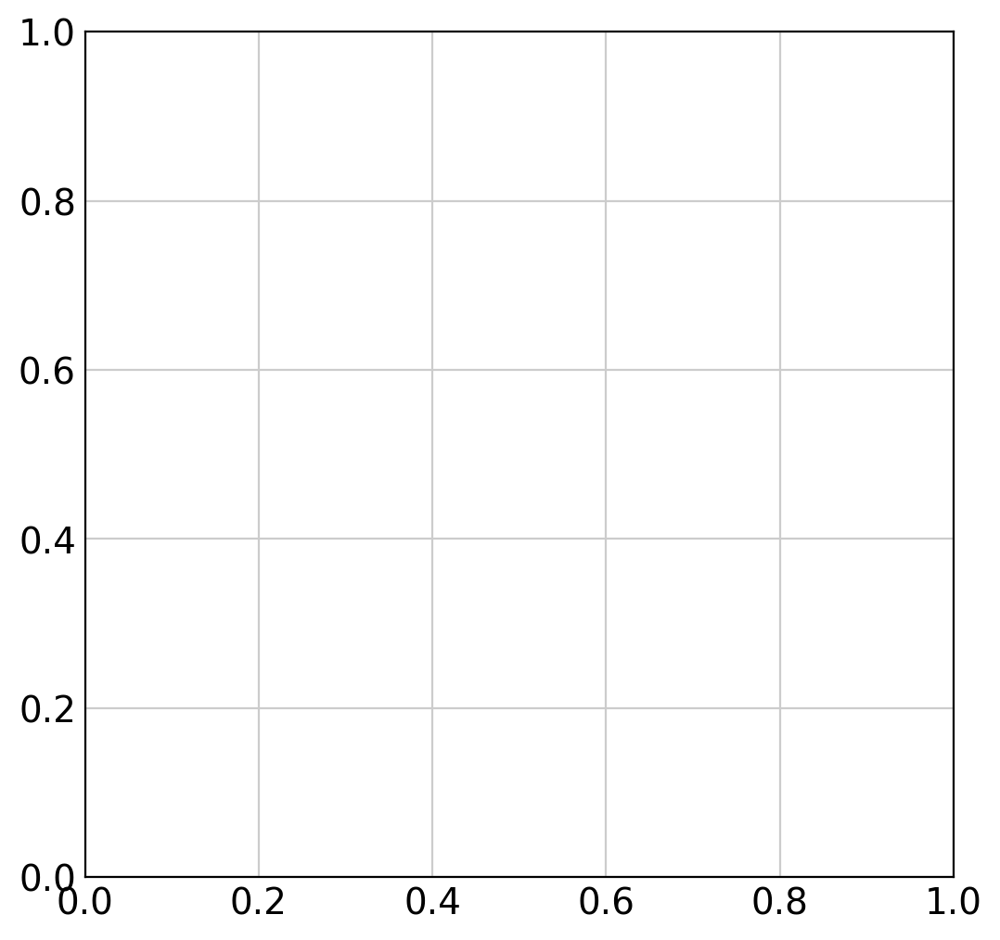

In [128]:
for col in adata.obs.iloc[:,5:-3].columns:
    sc.set_figure_params(scanpy=True, dpi=100,figsize=(6,6))
    plt.rcParams['figure.facecolor'] = 'white'
    sc.pl.umap(adata,color=[col],size=1,legend_fontsize=8,legend_fontoutline=2,show=False,cmap='viridis')
    plt.savefig('../../figures/celltype_identification_mscoronal/msbrain_3rep_'+str(col)+'.pdf',bbox_inches='tight')
    plt.show()

# Plotting clusters on the tissue

We now go back to the tissue and plot the clusters back. For this we use the function 'map_of_clusters' to plot clusters on the tissue

We plot clusters 6 and 9, which represent vascular popularions in two different regions

/mnt/c/Users/sergio.salas/Desktop/Xenium_benchmarking-main/Xenium_benchmarking-main/xb/plotting.py:22: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[key]=adata.obs[key].astype(int)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


727


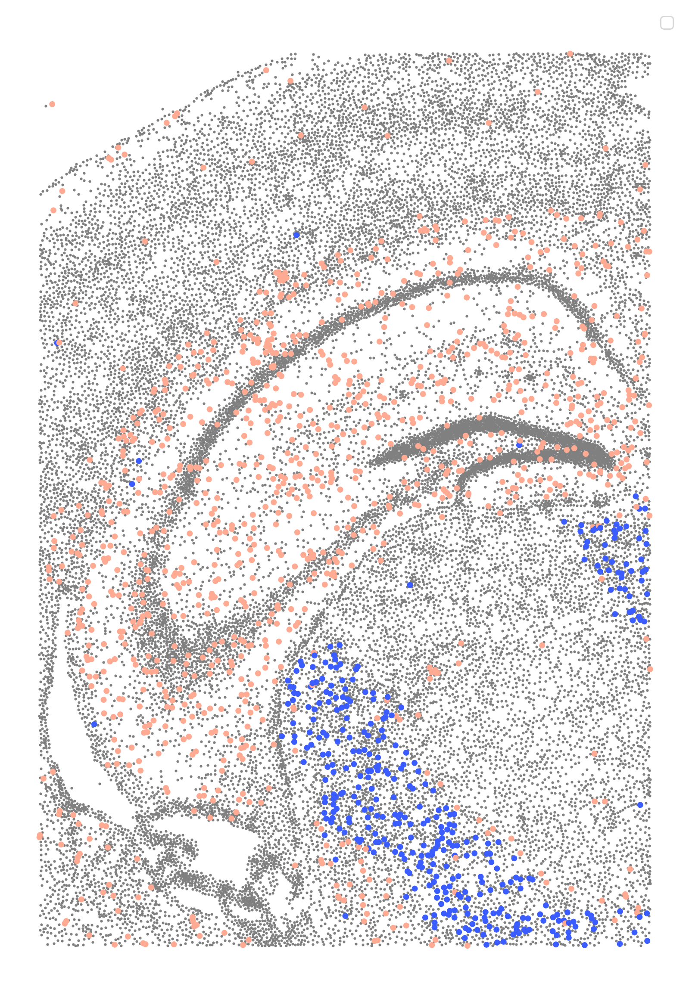

In [93]:
adatasub=adata[adata.obs['replicate']=='1']
xp.map_of_clusters(adatasub,key='leiden_1_4',size=25,background='white',clusters=['7','27'],figuresize=(10,15),save='../../figures/celltype_identification_mscoronal',format='pdf')

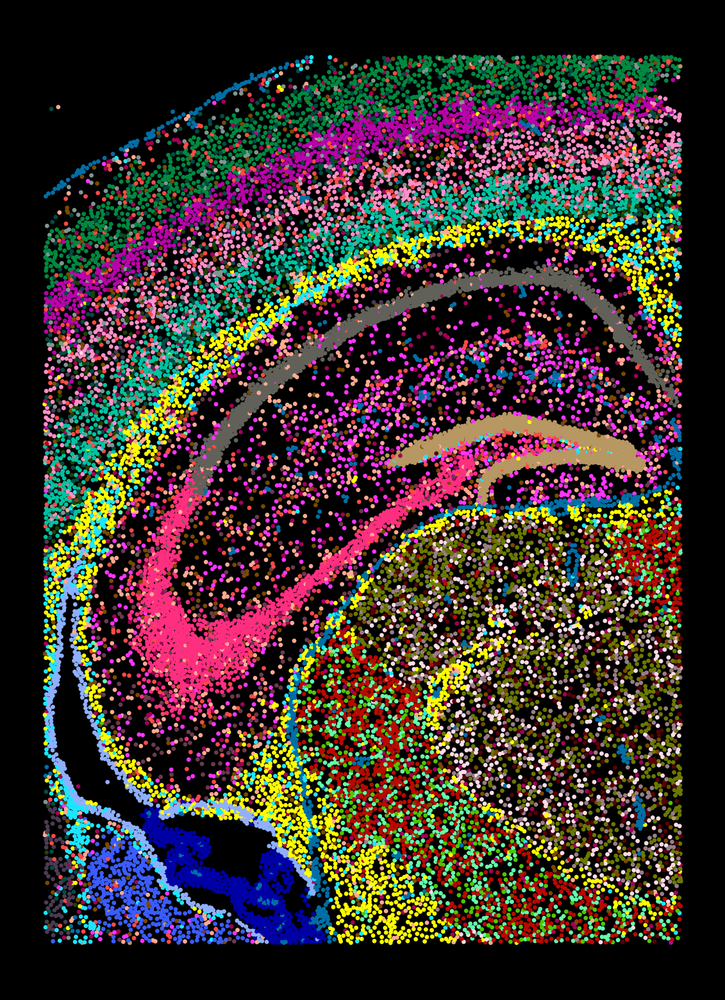

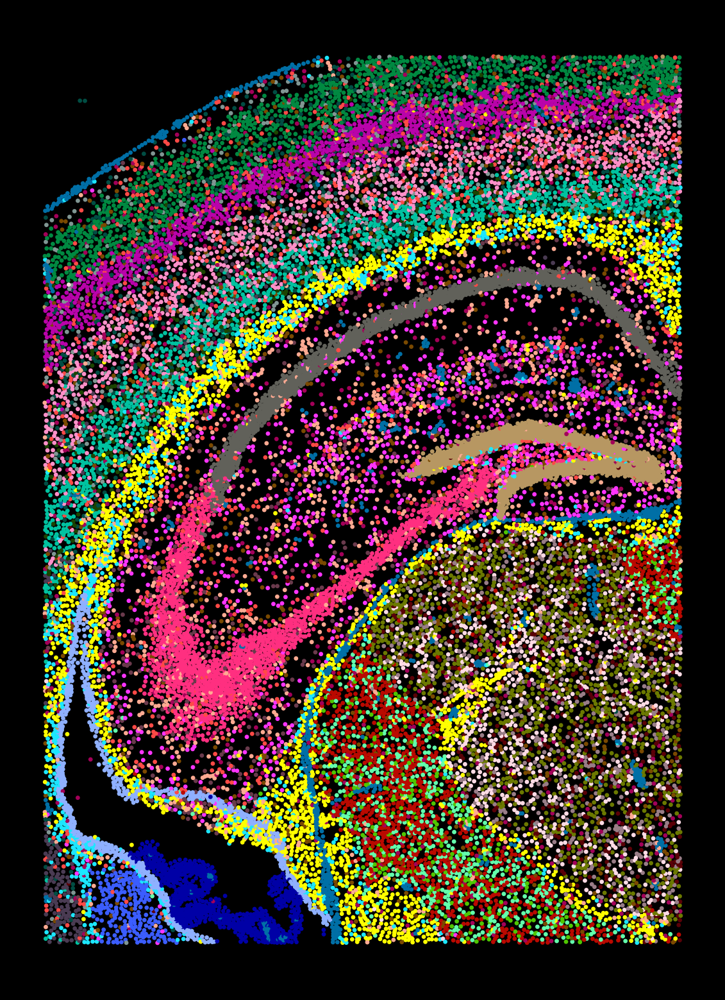

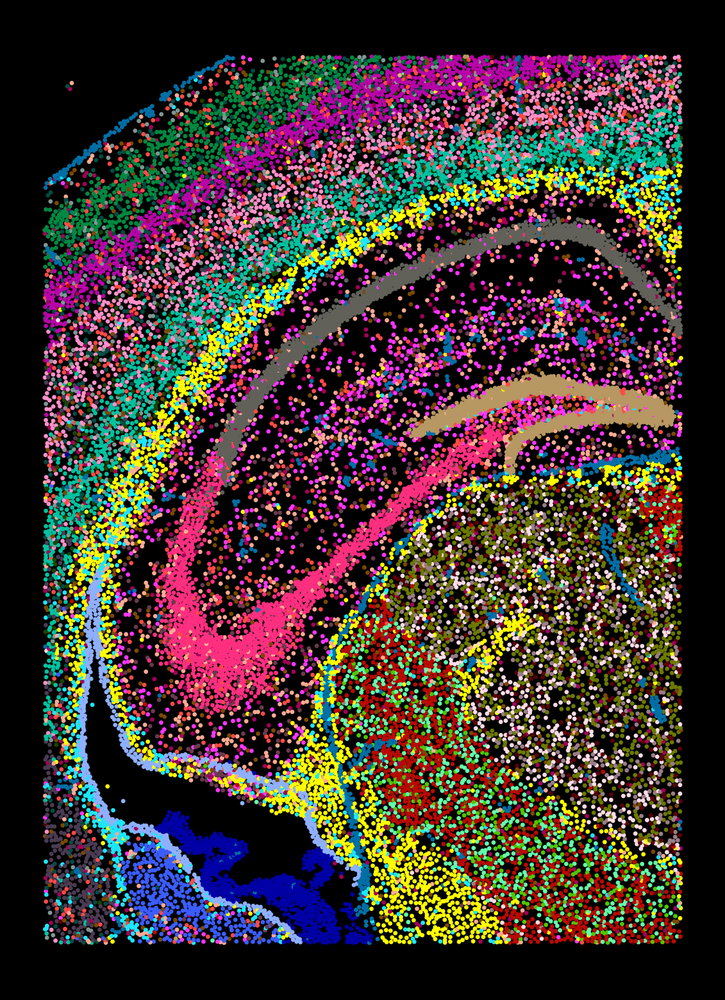

In [100]:
for s in adata.obs['replicate'].unique():
    adatasub=adata[adata.obs['replicate']==s]
    xp.map_of_clusters(adatasub,key='initial_annotation',size=6,background='black',clusters='all',figuresize=(7,10),save='../../figures/celltype_identification_mscoronal',format='jpg')

# Cell type consistency between replicates

In [101]:
crs=pd.crosstab(adata.obs['initial_annotation'],adata.obs['replicate'])
crs_perc=crs.div(crs.sum(axis=0),axis=1)*100

In [105]:
crs_perc


replicate,1,2,3
initial_annotation,,,
0_MFOL_NFOL,8.199894,8.535896,8.622135
1_DG,6.978068,6.474246,6.753074
2_CA3,5.782803,5.440096,5.579234
3_CA1,5.429916,5.360290,5.477921
4_INH_thalamus,4.940427,4.485751,5.226383
5_Excitatory thalamus,4.579950,4.595484,4.164338
6_L6 CT CTX,4.132200,4.119975,4.838597
7_Endo_pericytes_CA,3.957653,4.219732,4.049050
8_L5 IT,3.779312,3.953713,4.017608


/home/sergioms/.local/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


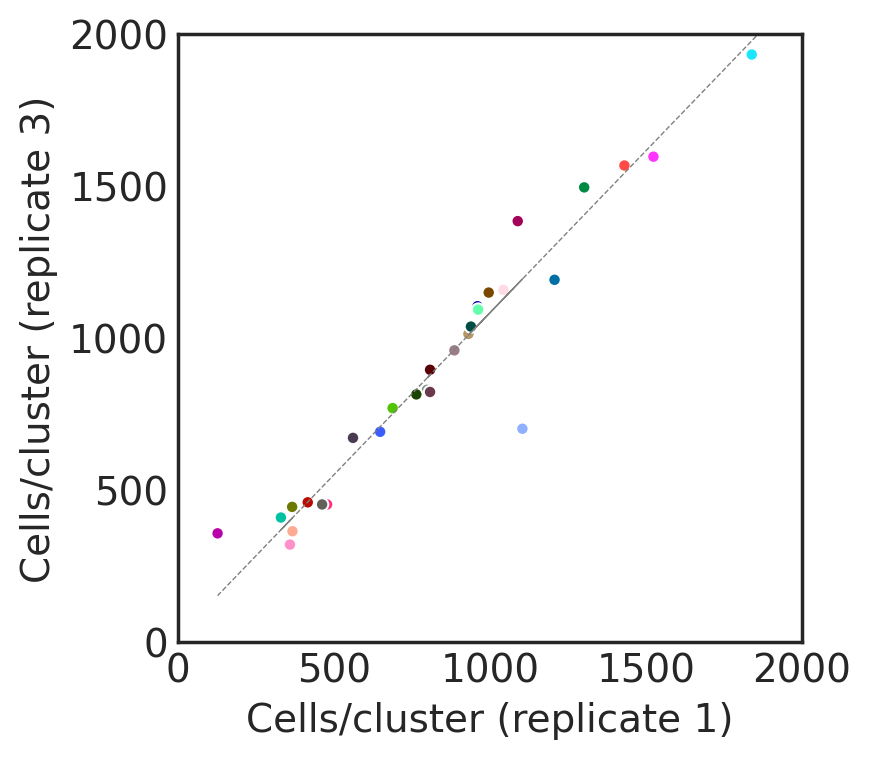

In [102]:
plt.style.use('seaborn-white')
m, b = np.polyfit(crs.iloc[:,0],crs.iloc[:,2], 1)
plt.figure(figsize=(4,4))
#add linear regression line to scatterplot 
plt.plot(crs.iloc[:,0], m*crs.iloc[:,0]+b,c='gray',linestyle='dashed',linewidth=0.5)
sns.scatterplot(crs.iloc[:,0],crs.iloc[:,2],s=80,c=adata.uns['leiden_1_4_colors'],marker='.')
plt.xlabel('Cells/cluster (replicate 1)')
plt.ylabel('Cells/cluster (replicate 3)')
plt.xlim([0,2000])
plt.ylim([0,2000])
plt.savefig('../../figures/celltype_identification_mscoronal/scatter_frequencies_13_upd.pdf')

seaborn-white


/home/sergioms/.local/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


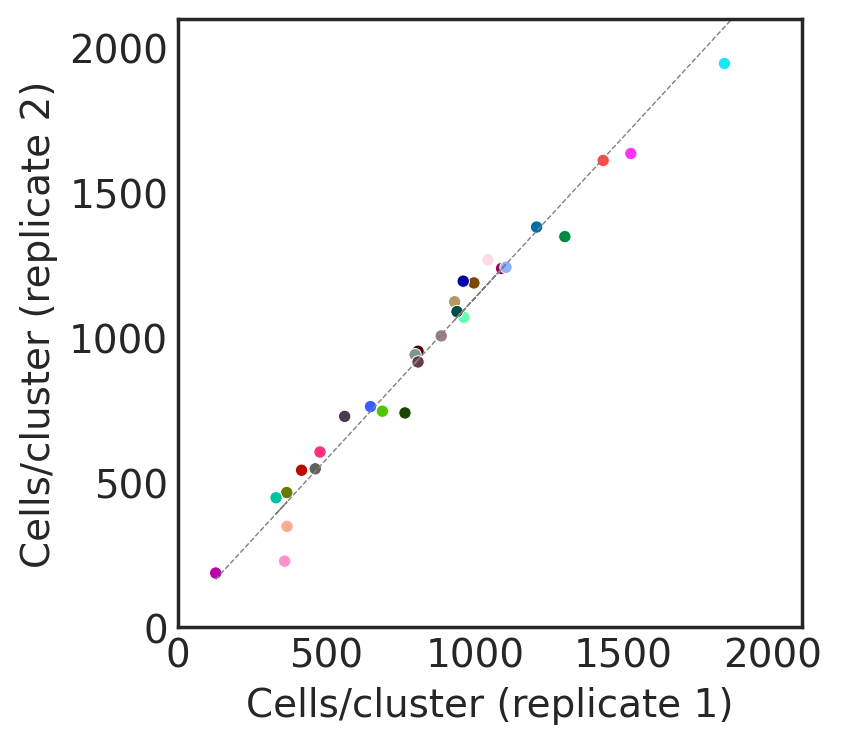

In [103]:
print('seaborn-white')
plt.style.use('seaborn-white')
m, b = np.polyfit(crs.iloc[:,0],crs.iloc[:,1], 1)
plt.figure(figsize=(4,4))
plt.plot(crs.iloc[:,0], m*crs.iloc[:,0]+b,c='gray',linestyle='dashed',linewidth=0.5)
sns.scatterplot(crs.iloc[:,0],crs.iloc[:,1],s=20,c=adata.uns['leiden_1_4_colors'])
plt.xlabel('Cells/cluster (replicate 1)')
plt.ylabel('Cells/cluster (replicate 2)')
plt.xlim([0,2100])
plt.ylim([0,2100])
plt.savefig('../../figures/celltype_identification_mscoronal/scatter_frequencies_12_upd.pdf')

These are the correlation values between the three replicates

In [106]:
print('Correlation between replicates 1 and 3 is:')
np.corrcoef(crs.iloc[:,2],crs.iloc[:,0])[0,1]

Correlation between replicates 1 and 3 is:


0.9715341201523507

In [107]:
print('Correlation between replicates 2 and 3 is:')
np.corrcoef(crs.iloc[:,1],crs.iloc[:,2])[0,1]

Correlation between replicates 2 and 3 is:


0.9693609305416029

In [108]:
print('Correlation between replicates 1 and 2 is:')
np.corrcoef(crs.iloc[:,1],crs.iloc[:,0])[0,1]

Correlation between replicates 1 and 2 is:


0.9892523977915366

In [ ]:
# for each replicate_save adataobs as csv

In [123]:
adata.obs['X_umap']=list(pd.DataFrame(adata.obsm['X_umap'])[0])
adata.obs['Y_umap']=list(pd.DataFrame(-adata.obsm['X_umap'])[1])
adata.obs['replicate'].unique()
for rep in adata.obs['replicate'].unique():
    adatasub=adata[adata.obs['replicate']==rep]
    adatasubobs=adatasub.obs
    adatasubobs.to_csv('../../data/celltyping_csv/mousebrain_rep'+str(rep)+'.csv')